# Activity Recognition in a Video Using CNN + LSTM

<center>
<img src='https://drive.google.com/uc?export=download&id=1ucdFpzyVbzTa7kPYsJ2av-gRKgd84ICA'></center>

## Importing Necessary Library

In [1]:
import os, cv2, math, random, pydot, graphviz
import numpy as np
import datetime as dt
import tensorflow as tf
import matplotlib.pyplot as plt
from pytube import YouTube
from moviepy.editor import *
from collections import deque
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras.callbacks import EarlyStopping
%matplotlib inline


I have utilized several Python libraries for this project:

- `os`: for operating system-related functionalities.
- `cv2`: OpenCV for image and video processing.
- `math` and `random`: for mathematical operations and random number generation.
- `numpy`: for numerical operations on arrays.
- `datetime`: for working with dates and times.
- `tensorflow`: the main deep learning framework for building and training the model.
- `matplotlib.pyplot`: for plotting graphs and visualizations.
- `collections.deque`: a double-ended queue for efficiently adding and removing elements.
- `pytube (from pytube import YouTube)`: Used for downloading YouTube videos for testing the model.
- `moviepy.editor`: for video editing operations.
- `sklearn.model_selection.train_test_split`: for splitting the dataset into training and testing sets.
- Various modules from `tensorflow.keras`: including layers, models, utilities, and callbacks.

In [2]:
seed_number = 27
np.random.seed(seed_number)
random.seed(seed_number)
tf.random.set_seed(seed_number)

I established the seed values for `Numpy`, `Python`, and `Tensorflow` to ensure consistent results with each execution.

## Visualize Sample Training Images and Labels

In the initial step, we will visually explore the data and associated labels to gain insight into the nature of the dataset. The dataset used is the [UCF50 - Action Recognition Dataset](https://www.crcv.ucf.edu/data/UCF50.php), which stands out for its realistic videos sourced from YouTube. This characteristic distinguishes it from many other action recognition datasets, which often feature staged performances by actors. The dataset comprises:

- **`50`** Action Categories
- **`25`** Groups of Videos per Action Category
- **`133`** Average Videos per Action Category
- **`199`** Average Number of Frames per Video
- **`320`** Average Frame Width per Video
- **`240`** Average Frame Height per Video
- **`26`** Average Frames Per Second per Video

For the visualization process, we will randomly select `20` categories from the dataset. Subsequently, for each selected category, we will choose a random video and visualize the first frame, along with the corresponding labels. This approach allows us to gain insights into a representative subset ( `20` random videos) of the entire dataset.

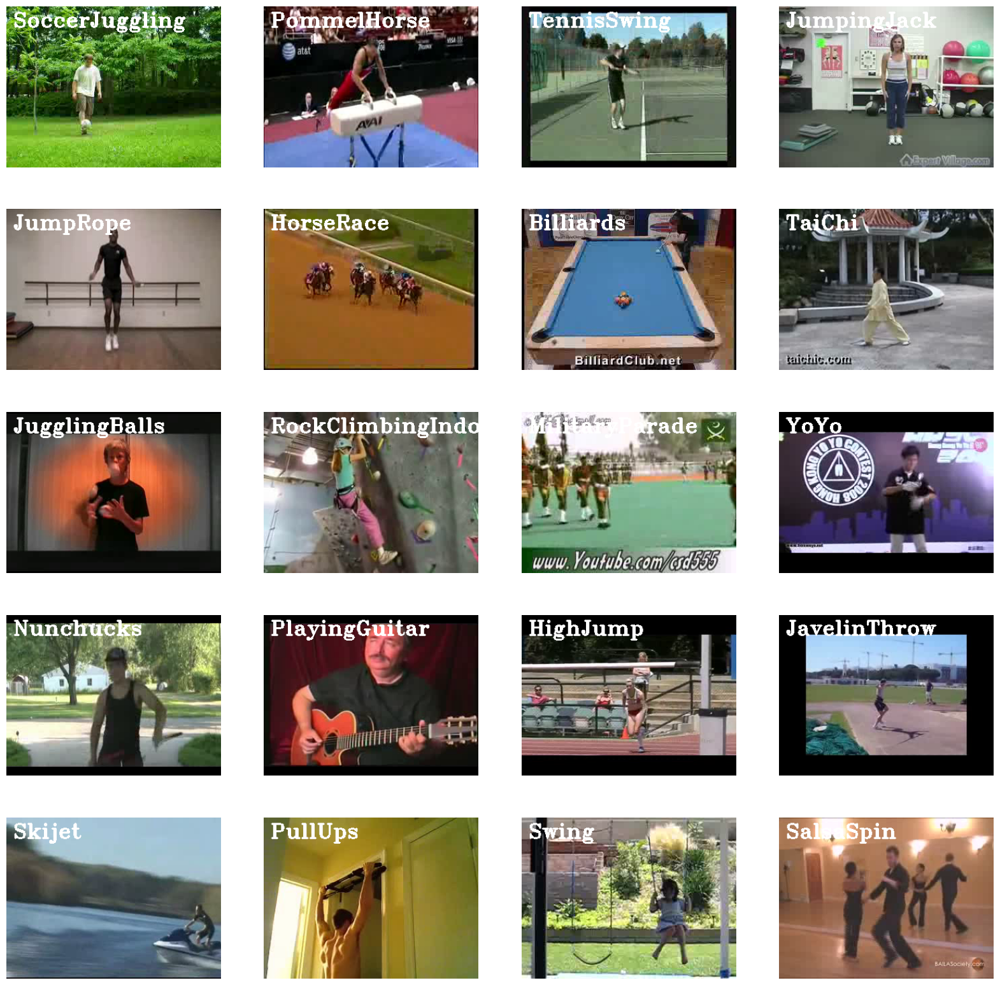

In [3]:
# Generate a Matplotlib figure and define its dimensions.
plt.figure(figsize=(20, 20))

# Retrieve the names of every class or category within UCF50 Dataset.
all_classes_names = os.listdir('dataset/UCF50')

# Produce a list comprising 20 randomly generated values. These values will fall 
# within the range of 0 to 50, with 50 representing the total number of classes
random_range = random.sample(range(len(all_classes_names)), 20)

# Looping through each of the randomly generated values.
for counter, random_index in enumerate(random_range, 1):
    # Get the name of the selected class.
    selected_class_name = all_classes_names[random_index]
    
    # Get a list of video files for the selected class.
    video_files_names_list = os.listdir(f'dataset/UCF50/{selected_class_name}')
    
    # Choose a random video file from the list.
    selected_video_file_name = random.choice(video_files_names_list)
    
    # Read the first frame from the selected video file.
    video_reader = cv2.VideoCapture(f'dataset/UCF50/{selected_class_name}/{selected_video_file_name}')
    _, bgr_frame = video_reader.read()
    video_reader.release()
    
    # Convert the frame from BGR to RGB.
    rgb_frame = cv2.cvtColor(bgr_frame, cv2.COLOR_BGR2RGB)
    
    # Add the class name as text on the frame.
    cv2.putText(rgb_frame, selected_class_name, (10, 30), cv2.FONT_HERSHEY_TRIPLEX, 1, (255, 255, 255), 2)
    
    # Display the frame in a subplot on the Matplotlib figure.
    plt.subplot(5, 4, counter); plt.imshow(rgb_frame); plt.axis('off')


## Data Preprocessing

Following this, we will conduct preprocessing on the dataset. Initially, we'll read the video files from the dataset and resize the frames of the videos to a consistent width and height. This resizing serves to decrease computational requirements. Additionally, we'll normalize the data to the range `[0-1]` by dividing the pixel values by `255`. This normalization accelerates convergence during the network training process.

*However, before proceeding, let's set up some constants.*

In [22]:
# Set the dimensions to which each video frame will be resized in our dataset.
IMAGE_HEIGHT, IMAGE_WIDTH = 64, 64

# Define the number of frames per video sequence fed to the model.
SEQUENCE_LENGTH = 20

# Designate the directory containing the UCF50 dataset. 
DATASET_DIR = "dataset/UCF50"

# Specify the list that holds the names of the classes intended for training. Feel free to select any desired set of classes.
all_classes_names = os.listdir('dataset/UCF50')[:5]
CLASSES_LIST = [
    "Biking",
    "Basketball",
    "WalkingWithDog",
    "SoccerJuggling",
    "TaiChi",
    "SkateBoarding",
    "BenchPress",
    "PushUps",
    "HorseRace",
    "Skiing",
    "BaseballPitch",
    "Billiards",
    "Swing"
]

13

**Note:** *The constants **`IMAGE_HEIGHT`**, **`IMAGE_WIDTH`**, and **`SEQUENCE_LENGTH`** can be adjusted for improved results. However, it's important to note that increasing the sequence length is effective only up to a certain point; beyond that, increasing the values will lead to higher computational costs.*

## Develop a Function for Extracting, Resizing, and Normalizing Frames


We will establish a function called **`frames_extraction()`** that generates a list containing resized and normalized frames from a video specified as its argument. This function will iteratively read the video file frame by frame, with not all frames being added to the list. Only an evenly distributed sequence length of frames will be included.

In [4]:
def frames_extraction(video_path):
    '''
    This function extracts the necessary frames from a video after resizing and normalization.
    Parameters:
        video_path: The disk path of the video from which frames are to be extracted.
    Returns:
        frames_list: A list containing the resized and normalized frames of the video.
    '''
    # Initialize an empty list to store frames.
    frames_list = []
    
    # Open the video file using OpenCV's VideoCapture.
    video_reader = cv2.VideoCapture(video_path)
    
    # Obtain the total number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
    
    # Calculate the window for skipping frames based on the desired sequence length.
    skip_frames_window = max(int(video_frames_count / SEQUENCE_LENGTH), 1)
    
    # Iterate through the frames to extract the required sequence.
    for frame_counter in range(SEQUENCE_LENGTH):
        # Set the position to read a specific frame based on the skip_frames_window.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)
        
        # Read the frame from the video.
        success, frame = video_reader.read()
        
        # Check for read success; if not, print an error message and exit the loop.
        if not success:
            print("Error reading video frames")
            break
        
        # Resize the frame to the specified dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the pixel values to the range [0, 1].
        normalized_frame = resized_frame / 255
        
        # Append the normalized frame to the frames_list.
        frames_list.append(normalized_frame)
    
    # Release the video reader.
    video_reader.release()
    
    # Return the list containing the resized and normalized frames.
    return frames_list


## Develop a Function for Dataset Generation



Next, we will establish a function named **`create_dataset()`**. This function will systematically go through all the classes listed in the **`CLASSES_LIST`** constant. For each class, it will invoke the **`frame_extraction()`** function on every video file associated with the selected classes. The function will then return the frames (**`features`**), class indices ( **`labels`**), and file paths of the video files (**`video_files_paths`**).

In [5]:
def create_dataset():
    '''
    This function will gather the data from the chosen classes and generate the necessary dataset.
    Returns:
        features:          A list containing the extracted frames of the videos.
        labels:            A list containing the indices of the classes corresponding to the videos.
        video_files_paths: A list containing the paths of the videos on the disk.
    '''
    # Initialize lists to store dataset components.
    features = []
    labels = []
    video_files_paths = []
    
    # Iterate through each class in the CLASSES_LIST.
    for class_index, class_name in enumerate(CLASSES_LIST):
        print(f'Extracting Data of Class: {class_name}')
        
        # Retrieve the list of files in the current class directory.
        files_list = os.listdir(os.path.join(DATASET_DIR, class_name))
        
        # Iterate through each file in the class.
        for file_name in files_list:
            # Construct the full path to the video file.
            video_file_path = os.path.join(DATASET_DIR, class_name, file_name)
            
            # Extract frames from the video file using the frames_extraction function.
            frames = frames_extraction(video_file_path)
            
            # Check if the extracted frames match the desired sequence length.
            if len(frames) == SEQUENCE_LENGTH:
                # Append the frames, class index, and video file path to the respective lists.
                features.append(frames)
                labels.append(class_index)
                video_files_paths.append(video_file_path)
    
    # Convert lists to numpy arrays.
    features = np.asarray(features)
    labels = np.array(labels)
    
    # Return the dataset components.
    return features, labels, video_files_paths


Now, we will employ the previously defined **`create_dataset()`** function to gather data from the chosen classes and generate the necessary dataset.

In [6]:
# Generate the dataset.
features, labels, video_files_paths = create_dataset()

Extracting Data of Class: Biking
Extracting Data of Class: Basketball
Extracting Data of Class: WalkingWithDog
Extracting Data of Class: SoccerJuggling
Extracting Data of Class: TaiChi
Extracting Data of Class: SkateBoarding
Extracting Data of Class: BenchPress
Extracting Data of Class: PushUps
Extracting Data of Class: HorseRace
Extracting Data of Class: Skiing
Extracting Data of Class: BaseballPitch
Extracting Data of Class: Billiards
Extracting Data of Class: Swing


Next, we will transform the `labels` (representing class indexes) into vectors using one-hot encoding.

In [7]:
# Utilizing Keras's `to_categorical` function to convert labels into vectors through one-hot encoding.
one_hot_encoded_labels = to_categorical(labels)

## Divide the Data into Training and Testing Sets


At this point, we possess the essential **`features`** (a NumPy array comprising all extracted video frames) and **`one_hot_encoded_labels`** (another NumPy array containing class labels in one-hot-encoded format). Consequently, we will partition our data to establish training and testing sets. Prior to the split, we will shuffle the dataset to prevent any bias and ensure the splits accurately represent the overall data distribution.

In [8]:
# Partition the data into a training set (75%) and a test set (25%).
features_train, features_test, labels_train, labels_test = train_test_split(features,
                                                                            one_hot_encoded_labels,
                                                                            test_size = 0.25,
                                                                            shuffle = True,
                                                                            random_state = seed_number)


## Implement the ConvLSTM Approach

In this stage, we will execute the initial approach by employing a combination of ConvLSTM cells. The ConvLSTM cell represents a variation of an LSTM network, incorporating convolution operations within the network architecture. Essentially, it is an LSTM structure with embedded convolutions, enabling it to discern spatial features in the data while considering the temporal relationships.

<center>
<img src="https://drive.google.com/uc?export=view&id=1KHN_JFWJoJi1xQj_bRdxy2QgevGOH1qP" width= 500px>
</center>

For video classification, this methodology adeptly captures the spatial relations within individual frames and the temporal relations across different frames. The ConvLSTM's ability to handle 3-dimensional input `(width, height, num_of_channels)` sets it apart from a simple LSTM, which only accommodates 1-dimensional input. Consequently, an LSTM alone is unsuitable for modeling spatiotemporal data.

For further insights into this architecture, refer to the paper [**Convolutional LSTM Network: A Machine Learning Approach for Precipitation Nowcasting**](https://arxiv.org/abs/1506.04214v1) by **Xingjian Shi** (NIPS 2015).

### Model Construction


To build the model, we will employ the Keras [**`ConvLSTM2D`**](https://keras.io/api/layers/recurrent_layers/conv_lstm2d) recurrent layers. The **`ConvLSTM2D`** layer necessitates the specification of the number of filters and the kernel size for implementing the convolutional operations. The output of these layers is ultimately flattened and supplied to the **`Dense`** layer with softmax activation, producing the probabilities for each action category.

Additionally, **`MaxPooling3D`** layers will be utilized to reduce frame dimensions, minimizing unnecessary computations. **`Dropout`** layers will also be incorporated to mitigate [overfitting](https://en.wikipedia.org/wiki/Overfitting) risks associated with the model learning the training data too precisely. The architecture is intentionally kept simple, containing a modest number of trainable parameters. This choice is deliberate, given that we are working with a limited subset of the dataset, which does not demand an expansive model.

In [23]:
def create_convlstm_model():
    '''
    This function will build the necessary ConvLSTM model.
    Returns:
        model: The completed ConvLSTM model as required.
    '''
    # Initialize a Sequential model.
    model = Sequential()
    
    # Add a ConvLSTM2D layer with specified parameters.
    model.add(ConvLSTM2D(filters=4, kernel_size=(3, 3), activation='tanh',
                         data_format="channels_last", recurrent_dropout=0.2, 
                         return_sequences=True, 
                         input_shape=(SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))
    
    # Add a MaxPooling3D layer with specified parameters.
    model.add(MaxPooling3D(pool_size=(1, 2, 2), padding='same', 
                           data_format='channels_last'))
    
    # Add a TimeDistributed layer with Dropout for regularization.
    model.add(TimeDistributed(Dropout(0.2)))
    
    # Repeat the pattern with additional ConvLSTM, MaxPooling3D, and TimeDistributed layers.
    # Note: Recurrent dropout is used for regularization.
    model.add(ConvLSTM2D(filters=8, kernel_size=(3, 3), activation='tanh', 
                         data_format="channels_last", 
                         recurrent_dropout=0.2, return_sequences=True))
    
    model.add(MaxPooling3D(pool_size=(1, 2, 2), padding='same', 
                           data_format='channels_last'))
    model.add(TimeDistributed(Dropout(0.2)))
    
    model.add(ConvLSTM2D(filters=14, kernel_size=(3, 3), activation='tanh', 
                         data_format="channels_last",
                         recurrent_dropout=0.2, return_sequences=True))
    
    model.add(MaxPooling3D(pool_size=(1, 2, 2), padding='same', 
                           data_format='channels_last'))
    model.add(TimeDistributed(Dropout(0.2)))
    
    model.add(ConvLSTM2D(filters=16, kernel_size=(3, 3), activation='tanh', 
                         data_format="channels_last",
                         recurrent_dropout=0.2, return_sequences=True))
    
    model.add(MaxPooling3D(pool_size=(1, 2, 2), padding='same', data_format='channels_last'))
    
    # Flatten the output.
    model.add(Flatten()) 
    
    # Add a Dense layer with softmax activation for classification.
    model.add(Dense(len(CLASSES_LIST), activation="softmax"))
    
    # Display model summary.
    model.summary()
    
    return model


Now, we will employ the previously defined function **`create_convlstm_model()`** to build the necessary `convlstm` model.

In [24]:
# Construct the required convlstm model.
convlstm_model = create_convlstm_model()

# Display the success message. 
print("Model Created Successfully!")

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv_lstm2d_4 (ConvLSTM2D)  (None, 20, 62, 62, 4)     1024      
                                                                 
 max_pooling3d_4 (MaxPooling  (None, 20, 31, 31, 4)    0         
 3D)                                                             
                                                                 
 time_distributed_15 (TimeDi  (None, 20, 31, 31, 4)    0         
 stributed)                                                      
                                                                 
 conv_lstm2d_5 (ConvLSTM2D)  (None, 20, 29, 29, 8)     3488      
                                                                 
 max_pooling3d_5 (MaxPooling  (None, 20, 15, 15, 8)    0         
 3D)                                                             
                                                      

## Compile & Train the Model


Following this, we will introduce an early stopping callback to mitigate the risk of [overfitting](https://en.wikipedia.org/wiki/Overfitting). Subsequently, we will commence the training process after compiling the model.

In [11]:
# Define an early stopping callback to monitor validation loss, with patience for improvement and restoration of best weights.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, mode='min', restore_best_weights=True)

# Compile the ConvLSTM model with categorical crossentropy loss, Adam optimizer, and accuracy as a metric.
convlstm_model.compile(loss='categorical_crossentropy', optimizer='Adam', metrics=['Accuracy'])

# Train the ConvLSTM model using training data, specifying epochs, batch size, shuffle, validation split, and callbacks.
convlstm_model_training_history = convlstm_model.fit(x=features_train, y=labels_train, epochs=20,
                                                     batch_size=4, shuffle=True, validation_split=0.2,
                                                     callbacks=[early_stopping_callback])


Epoch 1/20
110/110 [==============================] - 123s 999ms/step - loss: 1.8008 - Accuracy: 0.1899 - val_loss: 1.7841 - val_Accuracy: 0.1909
Epoch 2/20
110/110 [==============================] - 98s 887ms/step - loss: 1.7521 - Accuracy: 0.2471 - val_loss: 1.7311 - val_Accuracy: 0.3091
Epoch 3/20
110/110 [==============================] - 97s 878ms/step - loss: 1.6553 - Accuracy: 0.3021 - val_loss: 1.6648 - val_Accuracy: 0.2636
Epoch 4/20
110/110 [==============================] - 98s 888ms/step - loss: 1.4408 - Accuracy: 0.4119 - val_loss: 1.4624 - val_Accuracy: 0.4364
Epoch 5/20
110/110 [==============================] - 96s 876ms/step - loss: 1.1626 - Accuracy: 0.5378 - val_loss: 1.2383 - val_Accuracy: 0.5636
Epoch 6/20
110/110 [==============================] - 96s 876ms/step - loss: 0.8829 - Accuracy: 0.6773 - val_loss: 1.3677 - val_Accuracy: 0.5636
Epoch 7/20
110/110 [==============================] - 95s 868ms/step - loss: 0.7455 - Accuracy: 0.7323 - val_loss: 1.0973 - val_A

In [25]:
# Define an early stopping callback to monitor validation loss, with patience for improvement and restoration of best weights.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, mode='min', restore_best_weights=True)

# Compile the ConvLSTM model with categorical crossentropy loss, Adam optimizer, and accuracy as a metric.
convlstm_model.compile(loss='categorical_crossentropy', optimizer='Adam', metrics=['Accuracy'])

# Train the ConvLSTM model using training data, specifying epochs, batch size, shuffle, validation split, and callbacks.
convlstm_model_training_history = convlstm_model.fit(x=features_train, y=labels_train, epochs=50,
                                                     batch_size=4, shuffle=True, validation_split=0.2,
                                                     callbacks=[early_stopping_callback])


Epoch 1/50
110/110 [==============================] - 201s 2s/step - loss: 1.7990 - Accuracy: 0.2014 - val_loss: 1.7638 - val_Accuracy: 0.3273
Epoch 2/50
110/110 [==============================] - 176s 2s/step - loss: 1.6709 - Accuracy: 0.3478 - val_loss: 1.4846 - val_Accuracy: 0.4273
Epoch 3/50
110/110 [==============================] - 182s 2s/step - loss: 1.4404 - Accuracy: 0.4394 - val_loss: 1.3247 - val_Accuracy: 0.4545
Epoch 4/50
110/110 [==============================] - 182s 2s/step - loss: 1.1813 - Accuracy: 0.5217 - val_loss: 1.3389 - val_Accuracy: 0.4909
Epoch 5/50
110/110 [==============================] - 188s 2s/step - loss: 1.0066 - Accuracy: 0.5950 - val_loss: 1.0212 - val_Accuracy: 0.6091
Epoch 6/50
110/110 [==============================] - 184s 2s/step - loss: 0.7437 - Accuracy: 0.7300 - val_loss: 0.9209 - val_Accuracy: 0.6545
Epoch 7/50
110/110 [==============================] - 184s 2s/step - loss: 0.6540 - Accuracy: 0.7757 - val_loss: 0.8339 - val_Accuracy: 0.7545

## Assess the Trained Model

Following the training process, we will assess the model's performance on the test set.

In [12]:
model_evaluation_history = convlstm_model.evaluate(features_test, labels_test)

6/6 [==============================] - 5s 826ms/step - loss: 1.1096 - Accuracy: 0.8087


## Store the Model



At this point, we will store the model to circumvent the necessity of training it anew for each use.

In [13]:
# Retrieve loss and accuracy from the model evaluation history.
model_evaluation_loss, model_evaluation_accuracy = model_evaluation_history

# Define the date and time format.
date_time_format = '%Y_%m_%d_%H_%M_%S'

# Obtain the current date and time.
current_date_time_dt = dt.datetime.now()

# Convert the date and time to a string with the specified format.
current_date_time_string = dt.datetime.strftime(current_date_time_dt, date_time_format)

# Construct a unique file name based on date, time, loss, and accuracy.
model_file_name = f'convlstm_model_Date_Time_{current_date_time_string}___Loss_{model_evaluation_loss}___Accuracy_{model_evaluation_accuracy}.h5'

# Save the ConvLSTM model with the generated file name.
convlstm_model.save(model_file_name)


In [27]:
# Retrieve loss and accuracy from the model evaluation history.
model_evaluation_loss, model_evaluation_accuracy = model_evaluation_history

# Define the date and time format.
date_time_format = '%Y_%m_%d_%H_%M_%S'

# Obtain the current date and time.
current_date_time_dt = dt.datetime.now()

# Convert the date and time to a string with the specified format.
current_date_time_string = dt.datetime.strftime(current_date_time_dt, date_time_format)

# Construct a unique file name based on date, time, loss, and accuracy.
model_file_name = f'convlstm_model_Date_Time_{current_date_time_string}___Loss_{model_evaluation_loss}___Accuracy_{model_evaluation_accuracy}.h5'

# Save the ConvLSTM model with the generated file name.
convlstm_model.save(model_file_name)


## Plot Model’s Loss & Accuracy Curves

In this step, we will establish a function called plot_metric() to depict the training and validation metrics. As we already possess distinct metrics from our training and validation steps, the next step involves visualizing these metrics.

In [15]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):
    '''
    This function is designed to create a graph displaying the provided metrics.
    Parameters:
        model_training_history: A history object containing recorded training and validation 
                                loss values and metric values across consecutive epochs.
        metric_name_1:          The name of the first metric to be visualized in the graph.
        metric_name_2:          The name of the second metric to be visualized in the graph.
        plot_name:              The title of the graph.
    '''
    # Extract metric values from the training history.
    metric_value_1 = model_training_history.history[metric_name_1]
    metric_value_2 = model_training_history.history[metric_name_2]
    
    # Generate a range of epochs for x-axis.
    epochs = range(len(metric_value_1))
    
    # Plot the first metric in blue.
    plt.plot(epochs, metric_value_1, 'blue', label=metric_name_1)
    
    # Plot the second metric in red.
    plt.plot(epochs, metric_value_2, 'red', label=metric_name_2)
    
    # Set the title of the graph.
    plt.title(str(plot_name))
    
    # Add a legend to the graph.
    plt.legend()


Now, we will employ the previously defined function **`plot_metric()`** to create a visual representation and comprehend the metrics.

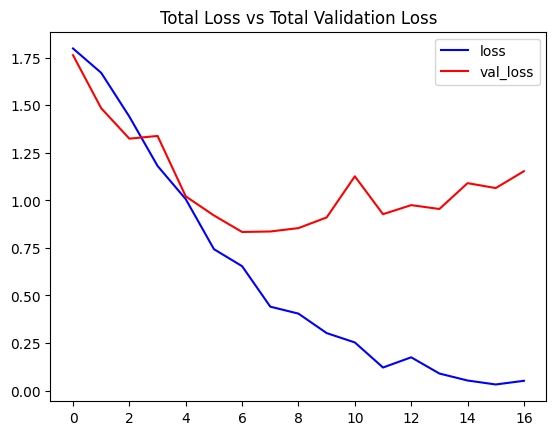

In [37]:
# Plot the training and validation loss metrics for visualization.
plot_metric(convlstm_model_training_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

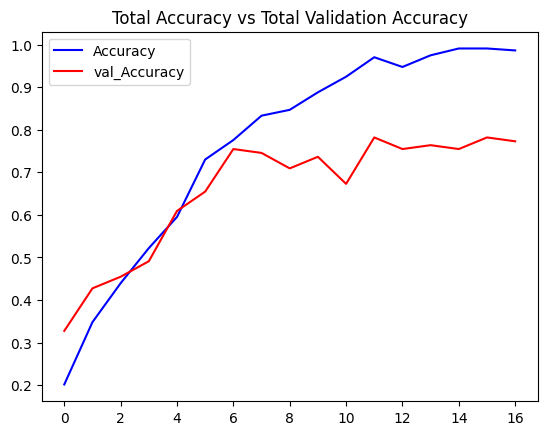

In [35]:
# Plot the training and validation accuracy metrics for visualization.
plot_metric(convlstm_model_training_history, 'Accuracy', 'val_Accuracy', 'Total Accuracy vs Total Validation Accuracy')

##  Implement the LRCN Approach

In this stage, we will implement the LRCN Approach, which combines Convolutional and LSTM layers within a single model. An alternative approach involves using separate CNN and LSTM models, with the CNN model extracting spatial features and a pre-trained model being fine-tuned for the task. Subsequently, the LSTM model utilizes these extracted features to predict the action in the video.

However, we will implement the Long-term Recurrent Convolutional Network (LRCN) approach, wherein CNN and LSTM layers are integrated into a unified model. Convolutional layers facilitate spatial feature extraction from video frames, and these spatial features are then input to LSTM layer(s) at each time-step for temporal sequence modeling. This approach enables the network to directly learn spatiotemporal features in an end-to-end training fashion, resulting in a robust model.

<center>
<img src='https://drive.google.com/uc?export=download&id=1I-q5yLsIoNh2chfzT7JYvra17FsXvdme'>
</center>

For a detailed understanding of this architecture, refer to the paper [Long-term Recurrent Convolutional Networks for Visual Recognition and Description](https://arxiv.org/abs/1411.4389?source=post_page---------------------------) by Jeff Donahue (CVPR 2015).

Additionally, we will incorporate the [**`TimeDistributed`**](https://keras.io/api/layers/recurrent_layers/time_distributed/) wrapper layer, enabling the application of the same layer to each frame of the video independently. This wrapper adapts a layer's input shape from `(width, height, num_of_channels)` to `(no_of_frames, width, height, num_of_channels)`. This capability is advantageous as it allows the entire video to be input into the model in a single step.

<center>
<img src='https://drive.google.com/uc?export=download&id=1CbauSm5XTY7ypHYBHH7rDSnJ5LO9CUWX' width=400>
</center>

## Construct the Model

In the process of realizing our LRCN architecture, we will employ time-distributed **`Conv2D`** layers, succeeded by **`MaxPooling2D`** and **`Dropout`** layers. The features derived from the **`Conv2D`** layers will undergo flattening through the **`Flatten`** layer and subsequently be input to an **`LSTM`** layer. The predictions for the performed action will be made by a **`Dense`** layer with softmax activation, utilizing the output from the **`LSTM`** layer.

In [9]:
def create_LRCN_model():
    '''
    This function will build the necessary LRCN model.
    Returns:
        model: The completed LRCN model as required.
    '''

    # Utilize a Sequential model for model construction.
    model = Sequential()
    
    # TimeDistributed Conv2D layer with 16 filters, kernel size (3, 3), padding, and ReLU activation.
    model.add(TimeDistributed(Conv2D(16, (3, 3), padding='same', activation='relu'),
                              input_shape=(SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))
    
    # TimeDistributed MaxPooling2D layer with pool size (4, 4).
    model.add(TimeDistributed(MaxPooling2D((4, 4)))) 
    # TimeDistributed Dropout layer with dropout rate of 0.25.
    model.add(TimeDistributed(Dropout(0.25)))
    
    # TimeDistributed Conv2D layer with 32 filters, kernel size (3, 3), padding, and ReLU activation.
    model.add(TimeDistributed(Conv2D(32, (3, 3), padding='same', activation='relu')))
    # TimeDistributed MaxPooling2D layer with pool size (4, 4).
    model.add(TimeDistributed(MaxPooling2D((4, 4))))
    # TimeDistributed Dropout layer with dropout rate of 0.25.
    model.add(TimeDistributed(Dropout(0.25)))
    
    # TimeDistributed Conv2D layer with 64 filters, kernel size (3, 3), padding, and ReLU activation.
    model.add(TimeDistributed(Conv2D(64, (3, 3), padding='same', activation='relu')))
    # TimeDistributed MaxPooling2D layer with pool size (2, 2).
    model.add(TimeDistributed(MaxPooling2D((2, 2))))
    # TimeDistributed Dropout layer with dropout rate of 0.25.
    model.add(TimeDistributed(Dropout(0.25)))
    
    # TimeDistributed Conv2D layer with 64 filters, kernel size (3, 3), padding, and ReLU activation.
    model.add(TimeDistributed(Conv2D(64, (3, 3), padding='same', activation='relu')))
    # TimeDistributed MaxPooling2D layer with pool size (2, 2).
    model.add(TimeDistributed(MaxPooling2D((2, 2))))
                                      
    # TimeDistributed Flatten layer.
    model.add(TimeDistributed(Flatten()))
                                      
    # LSTM layer with 32 units.
    model.add(LSTM(32))
                                      
    # Dense layer with softmax activation for classification.
    model.add(Dense(len(CLASSES_LIST), activation='softmax'))

    # Display the model's summary.
    model.summary()
    
    # Return the constructed LRCN model.
    return model


Now we will use the previously defined function **`create_LRCN_model()`** to build the necessary `LRCN` model.

In [10]:
# Create an LRCN model using the specified function.
LRCN_model = create_LRCN_model()

# Print a success message indicating the model creation.
print("Model Created Successfully!")


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, 20, 64, 64, 16)   448       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, 20, 16, 16, 16)   0         
 tributed)                                                       
                                                                 
 time_distributed_2 (TimeDis  (None, 20, 16, 16, 16)   0         
 tributed)                                                       
                                                                 
 time_distributed_3 (TimeDis  (None, 20, 16, 16, 32)   4640      
 tributed)                                                       
                                                                 
 time_distributed_4 (TimeDis  (None, 20, 4, 4, 32)     0

In [29]:
# Create an LRCN model using the specified function.
LRCN_model = create_LRCN_model()

# Print a success message indicating the model creation.
print("Model Created Successfully!")


Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed_18 (TimeDi  (None, 20, 64, 64, 16)   448       
 stributed)                                                      
                                                                 
 time_distributed_19 (TimeDi  (None, 20, 16, 16, 16)   0         
 stributed)                                                      
                                                                 
 time_distributed_20 (TimeDi  (None, 20, 16, 16, 16)   0         
 stributed)                                                      
                                                                 
 time_distributed_21 (TimeDi  (None, 20, 16, 16, 32)   4640      
 stributed)                                                      
                                                                 
 time_distributed_22 (TimeDi  (None, 20, 4, 4, 32)    

## Compile & Train the Model

Following the model structure inspection, we will proceed to compile and initiate the training process.

In [20]:
# Define an early stopping callback to prevent overfitting.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=15,
                                        mode='min', restore_best_weights=True)

# Compile the LRCN model with categorical crossentropy loss and Adam optimizer.
LRCN_model.compile(loss='categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])

# Train the LRCN model on the training data.
LRCN_model_training_history = LRCN_model.fit(x=features_train, y=labels_train,
                                            epochs=50, batch_size=4, shuffle=True,
                                            validation_split=0.2, callbacks=[early_stopping_callback])


Epoch 1/20
110/110 [==============================] - 22s 151ms/step - loss: 1.8032 - accuracy: 0.1854 - val_loss: 1.7883 - val_accuracy: 0.2727
Epoch 2/20
110/110 [==============================] - 12s 108ms/step - loss: 1.7773 - accuracy: 0.2082 - val_loss: 1.7526 - val_accuracy: 0.2727
Epoch 3/20
110/110 [==============================] - 12s 106ms/step - loss: 1.7001 - accuracy: 0.3112 - val_loss: 1.6867 - val_accuracy: 0.3273
Epoch 4/20
110/110 [==============================] - 12s 106ms/step - loss: 1.5832 - accuracy: 0.3844 - val_loss: 1.5591 - val_accuracy: 0.4364
Epoch 5/20
110/110 [==============================] - 12s 105ms/step - loss: 1.3870 - accuracy: 0.4600 - val_loss: 1.4243 - val_accuracy: 0.3909
Epoch 6/20
110/110 [==============================] - 12s 106ms/step - loss: 1.2555 - accuracy: 0.5149 - val_loss: 1.2770 - val_accuracy: 0.4455
Epoch 7/20
110/110 [==============================] - 12s 110ms/step - loss: 1.1631 - accuracy: 0.5789 - val_loss: 1.2397 - val_ac

In [13]:
# Define an early stopping callback to prevent overfitting.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=15,
                                        mode='min', restore_best_weights=True)

# Compile the LRCN model with categorical crossentropy loss and Adam optimizer.
LRCN_model.compile(loss='categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])

# Train the LRCN model on the training data.
LRCN_model_training_history = LRCN_model.fit(x=features_train, y=labels_train,
                                            epochs=70, batch_size=4, shuffle=True,
                                            validation_split=0.2, callbacks=[early_stopping_callback])


Epoch 1/70
263/263 [==============================] - 42s 134ms/step - loss: 2.4956 - accuracy: 0.1131 - val_loss: 2.3331 - val_accuracy: 0.1894
Epoch 2/70
263/263 [==============================] - 29s 109ms/step - loss: 2.1750 - accuracy: 0.2671 - val_loss: 1.9263 - val_accuracy: 0.3144
Epoch 3/70
263/263 [==============================] - 27s 102ms/step - loss: 1.9469 - accuracy: 0.3289 - val_loss: 1.8441 - val_accuracy: 0.3977
Epoch 4/70
263/263 [==============================] - 27s 101ms/step - loss: 1.7855 - accuracy: 0.3878 - val_loss: 1.6197 - val_accuracy: 0.4697
Epoch 5/70
263/263 [==============================] - 28s 108ms/step - loss: 1.6964 - accuracy: 0.4144 - val_loss: 1.5343 - val_accuracy: 0.5076
Epoch 6/70
263/263 [==============================] - 27s 102ms/step - loss: 1.5725 - accuracy: 0.4686 - val_loss: 1.5005 - val_accuracy: 0.4962
Epoch 7/70
263/263 [==============================] - 27s 101ms/step - loss: 1.4457 - accuracy: 0.5190 - val_loss: 1.4292 - val_ac

In [11]:
# Define an early stopping callback to prevent overfitting.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=15,
                                        mode='min', restore_best_weights=True)

# Compile the LRCN model with categorical crossentropy loss and Adam optimizer.
LRCN_model.compile(loss='categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])

# Train the LRCN model on the training data.
LRCN_model_training_history = LRCN_model.fit(x=features_train, y=labels_train,
                                            epochs=50, batch_size=4, shuffle=True,
                                            validation_split=0.2, callbacks=[early_stopping_callback])


Epoch 1/50
263/263 [==============================] - 40s 133ms/step - loss: 2.4810 - accuracy: 0.1331 - val_loss: 2.3191 - val_accuracy: 0.2159
Epoch 2/50
263/263 [==============================] - 27s 102ms/step - loss: 2.2165 - accuracy: 0.2519 - val_loss: 2.0682 - val_accuracy: 0.3409
Epoch 3/50
263/263 [==============================] - 26s 97ms/step - loss: 1.9567 - accuracy: 0.3422 - val_loss: 1.9118 - val_accuracy: 0.3902
Epoch 4/50
263/263 [==============================] - 26s 98ms/step - loss: 1.8446 - accuracy: 0.3821 - val_loss: 1.8462 - val_accuracy: 0.4015
Epoch 5/50
263/263 [==============================] - 28s 106ms/step - loss: 1.7345 - accuracy: 0.4154 - val_loss: 1.7190 - val_accuracy: 0.4242
Epoch 6/50
263/263 [==============================] - 28s 105ms/step - loss: 1.6184 - accuracy: 0.4563 - val_loss: 1.5687 - val_accuracy: 0.4886
Epoch 7/50
263/263 [==============================] - 27s 101ms/step - loss: 1.5132 - accuracy: 0.4781 - val_loss: 1.4651 - val_accu

In [ ]:
# Define an early stopping callback to prevent overfitting.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=15,
                                        mode='min', restore_best_weights=True)

# Compile the LRCN model with categorical crossentropy loss and Adam optimizer.
LRCN_model.compile(loss='categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])

# Train the LRCN model on the training data.
LRCN_model_training_history = LRCN_model.fit(x=features_train, y=labels_train,
                                            epochs=60, batch_size=4, shuffle=True,
                                            validation_split=0.2, callbacks=[early_stopping_callback])


## Assessing the Trained Model

Similar to the previous step, we will assess the performance of the trained `LRCN` model on the test set.

In [14]:
model_evaluation_history = LRCN_model.evaluate(features_test, labels_test)

14/14 [==============================] - 4s 156ms/step - loss: 0.7498 - accuracy: 0.8087


In [14]:
model_evaluation_history = LRCN_model.evaluate(features_test, labels_test)

14/14 [==============================] - 4s 156ms/step - loss: 0.7498 - accuracy: 0.8087


In [12]:
model_evaluation_history = LRCN_model.evaluate(features_test, labels_test)

14/14 [==============================] - 3s 149ms/step - loss: 1.0063 - accuracy: 0.8064


## Store the Model



At this point, we will store the model to circumvent the necessity of training it anew for each use.

In [13]:
# Retrieve loss and accuracy from the model evaluation history.
model_evaluation_loss, model_evaluation_accuracy = model_evaluation_history

# Define the date and time format.
date_time_format = '%Y_%m_%d_%H_%M_%S'

# Obtain the current date and time.
current_date_time_dt = dt.datetime.now()

# Convert the date and time to a string with the specified format.
current_date_time_string = dt.datetime.strftime(current_date_time_dt, date_time_format)

# Construct a unique file name based on date, time, loss, and accuracy.
model_file_name = f'LRCN_model_Date_Time_{current_date_time_string}___Loss_{model_evaluation_loss}___Accuracy_{model_evaluation_accuracy}.h5'

# Save the ConvLSTM model with the generated file name.
LRCN_model.save(model_file_name)


## Plot Model’s Loss & Accuracy Curves

Now, we will employ the previously defined function **`plot_metric()`** to create a visual representation and comprehend the metrics.

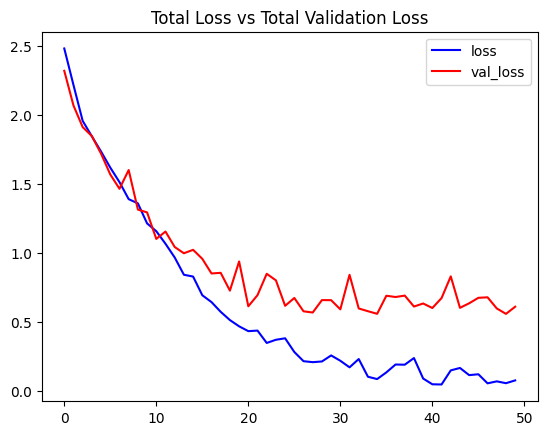

In [16]:
# Plot the training and validation loss metrics for visualization.
plot_metric(LRCN_model_training_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

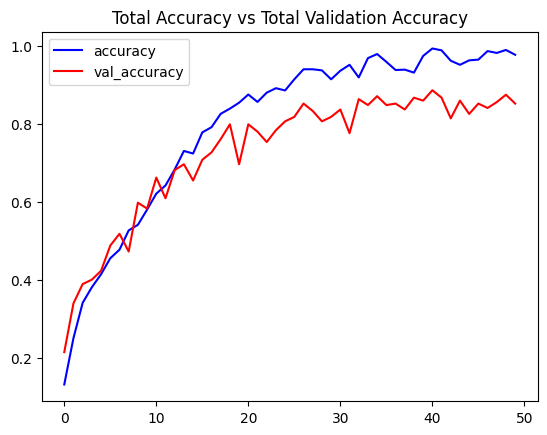

In [17]:
# Plot the training and validation loss metrics for visualization.
plot_metric(LRCN_model_training_history, 'accuracy', 'val_accuracy', 'Total Accuracy vs Total Validation Accuracy')

##  Evaluate the Top-Performing Model on YouTube Videos

Considering the promising outcomes, particularly for a limited set of classes, we will now assess the performance of the `LRCN` model on various YouTube videos.

## Develop a Function for Downloading YouTube Videos

We will establish a function called **`download_youtube_videos()`** to initiate the download of YouTube videos, leveraging the **`pafy`** library. This library facilitates the download process with just a video URL, obtaining relevant metadata such as the video title.

In [18]:
def download_youtube_videos(youtube_video_url, output_directory):
    '''
    This function downloads the YouTube video specified by the provided URL.
    Args:
        youtube_video_url: URL of the video to be downloaded.
        output_directory: The directory path where the downloaded video will be stored.
    Returns:
        title: The title of the downloaded YouTube video.
    '''
    # Create a YouTube object for the YouTube video.
    youtube_video = YouTube(youtube_video_url)
    
    # Obtain the title of the video.
    title = youtube_video.title
    
    # Retrieve the stream with the highest resolution.
    video_stream = youtube_video.streams.get_highest_resolution()
    
    # Define the output file path using the video title.
    output_file_path = f'{output_directory}/{title}.mp4'
    
    # Download the video to the specified output directory.
    video_stream.download(output_directory)
    
    # Return the title of the downloaded YouTube video.
    return title


## Download a Test Video

Now we will use the previously created **`download_youtube_videos()`** function to download a YouTube video for testing the `LRCN` model.

In [19]:
# Specify the directory where test videos will be stored.
test_videos_directory = 'test_videos'
# Create the test videos directory if it doesn't exist.
os.makedirs(test_videos_directory, exist_ok=True)
# Download a YouTube video for testing using the specified URL and directory.
video_title = download_youtube_videos('https://www.youtube.com/watch?v=8u0qjmHIOcE', test_videos_directory)
# Form the file path for the downloaded video.
input_video_file_path = f'{test_videos_directory}/{video_title}.mp4'


## Create a Function for Action Recognition in Videos

In the following steps, we will define a function called **`predict_on_video()`**. This function reads a video frame by frame from a specified path, performs action recognition on the video, and saves the results.


In [20]:
def predict_on_video(video_file_path, output_file_path, SEQUENCE_LENGTH):
    '''
    This function conducts action recognition on a video using the LRCN model.
    Parameters:
    video_file_path: Path to the video on disk for action recognition.
    output_file_path: Path to store the output video with overlaid predicted actions.
    SEQUENCE_LENGTH: Fixed number of frames forming a sequence input for the model.
    '''
    # Open the video file for reading.
    video_reader = cv2.VideoCapture(video_file_path)
    
    # Get the original video dimensions.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
    
    # Open a video file for writing with the same dimensions and frame rate.
    video_writer = cv2.VideoWriter(output_file_path, 
                                   cv2.VideoWriter_fourcc('M', 'P', '4', 'V'), 
                                   video_reader.get(cv2.CAP_PROP_FPS), 
                                   (original_video_width, original_video_height))
    
    # Initialize a deque to store frames for sequence input.
    frames_queue = deque(maxlen=SEQUENCE_LENGTH)
    
    # Initialize the predicted class name.
    predicted_class_name = ''
    
    # Process each frame in the video.
    while video_reader.isOpened():
        ok, frame = video_reader.read()
        if not ok:
            break
        
        # Resize the frame to the required input size.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the frame values.
        normalized_frame = resized_frame / 255
        
        # Add the normalized frame to the frames queue.
        frames_queue.append(normalized_frame)
        
        # If the queue is full, make a prediction.
        if len(frames_queue) == SEQUENCE_LENGTH:
            predicted_labels_probabilities = LRCN_model.predict(np.expand_dims(frames_queue, axis=0))[0]
            predicted_label = np.argmax(predicted_labels_probabilities)
            predicted_class_name = CLASSES_LIST[predicted_label]
        
        # Overlay the predicted class name on the frame.
        cv2.putText(frame, predicted_class_name, (10, 30), 
                    cv2.FONT_HERSHEY_TRIPLEX, 1, (0, 255, 0), 2)
        
        # Write the frame to the output video file.
        video_writer.write(frame)
    
    # Release video readers and writers.
    video_reader.release()
    video_writer.release()


## Execute Action Recognition on the Test Video

Now, we will apply the function **`predict_on_video()`** previously developed to conduct action recognition on the test video obtained through the **`download_youtube_videos()`** function. Subsequently, we will showcase the resulting video with the superimposed predicted actions.

In [21]:
# Formulate the file path for the output video.
output_video_file_path = f'{test_videos_directory}/{video_title}--Output-SeqLen{SEQUENCE_LENGTH}.mp4'

# Apply action recognition to the test video and generate the output video with predictions.
predict_on_video(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Display the resulting video with the superimposed predicted actions.
VideoFileClip(output_video_file_path, audio=False, target_resolution=(300, None)).ipython_display()


1/1 [==============================] - 0s 27ms/step
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## Generate a Function for Single Video Prediction

Now, I'll define a function for making a single prediction on entire videos. It involves extracting evenly distributed **N** **`(SEQUENCE_LENGTH)`** frames from the entire video, which is particularly beneficial when dealing with videos focused on a single activity. This strategy optimizes computational efficiency and time in such cases.


In [57]:
def predict_single_action(video_file_path, SEQUENCE_LENGTH):
    '''
    This function will predict a single action in a video using the LRCN model.
    Args:
    video_file_path:  The path of the video stored on disk for action recognition.
    SEQUENCE_LENGTH:  The fixed number of frames in a video passed as one sequence to the model.
    '''
    # Open the video file for reading.
    video_reader = cv2.VideoCapture(video_file_path)
    
    # Retrieve the original video dimensions.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
    
    # Initialize an empty list to store frames.
    frames_list = []
    
    # Initialize the predicted class name.
    predicted_class_name = ''
    
    # Get the total number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
    
    # Calculate the skip window to evenly sample frames for the sequence.
    skip_frames_window = max(int(video_frames_count / SEQUENCE_LENGTH), 1)
    
    # Iterate through the frames to build the sequence.
    for frame_counter in range(SEQUENCE_LENGTH):
        # Set the video reader to the frame specified by the skip window.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)
        
        # Read the frame from the video.
        success, frame = video_reader.read()
        
        # Break if the frame reading was unsuccessful.
        if not success:
            break
        
        # Resize the frame to the desired input size.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the pixel values to the range [0, 1].
        normalized_frame = resized_frame / 255
        
        # Append the normalized frame to the list.
        frames_list.append(normalized_frame)
    
    # Perform action recognition on the sequence of frames.
    predicted_labels_probabilities = LRCN_model.predict(np.expand_dims(frames_list, axis=0))[0]
    
    # Determine the predicted action label.
    predicted_label = np.argmax(predicted_labels_probabilities)
    
    # Map the label to the corresponding action class name.
    predicted_class_name = CLASSES_LIST[predicted_label]
    
    # Display the predicted action and confidence.
    print(f'Action Predicted: {predicted_class_name}\nConfidence: {predicted_labels_probabilities[predicted_label]}')
    
    # Release the video reader.
    video_reader.release()


## Conduct a Singular Prediction on a Test Video

Now, I will use the previously established function **`predict_single_action()`** to make a singular prediction on an entire YouTube test video, which will be downloaded using the previously defined function **`download_youtube_videos()`**.

In [61]:
# Download the YouTube video.
video_title = download_youtube_videos('https://youtu.be/fc3w827kwyA', test_videos_directory)

# Construct the input YouTube video path.
input_video_file_path = f'{test_videos_directory}/{video_title}.mp4'

# Perform a Single Prediction on the Test Video.
predict_single_action(input_video_file_path, SEQUENCE_LENGTH)

# Display the input video with an increased maxduration.
VideoFileClip(input_video_file_path, audio=False, 
              target_resolution=(300, None)).ipython_display(maxduration=5000)


1/1 [==============================] - 0s 67ms/step
Action Predicted: TaiChi
Confidence: 0.9097801446914673
Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


# Streamlit User-Friendly Version

I have also developed a Streamlit one-click version of the Action Recognition model, making it incredibly user-friendly. With this version, users can effortlessly recognize actions in a video by simply clicking a single button.

To explore the Streamlit version, click the button below:

[Explore Streamlit Version](https://activity-recognition-project.streamlit.app/)
